<html>
<head>
<style>
.center {
  text-align: center;
}
h3 {
  font-size: 24px;
}
</style>
</head>
<body>

<div class="center">
  <img src="bzu logo.png" alt="Birzeit University Logo" style="margin-bottom: 20px;"><br>
  <h2>Intelligent Systems Lab – ENCS5141</h2>
  <h2>Assignment #3</h2>
  <h2>Image Segmentation with Clustering Algorithms</h2>
  <h3>Student Name: Islam Jihad</h3>
  <h3>Student ID: 1191375</h3>
  <h3>Department of Electrical & Computer Engineering</h3>
  <h3>Birzeit University</h3>
  <h3>Date of Submission: 12.01.2024</h3>
</div>

</body>
</html>



---

### Introduction

**Image Segmentation in Computer Vision**

An essential procedure in computer vision is image segmentation. It is the process of breaking up a digital image into many segments (groups of pixels, often referred to as image objects) in order to make the representation of the image simpler or more easily interpreted and analyzed. Finding boundaries (lines, curves, etc.) and objects in photos is usually accomplished using image segmentation.

**Applications of Image Segmentation**

Image segmentation has a wide range of uses. These include, but are not restricted to, face recognition, object-based editing in photography and videography, medical imaging (e.g., tumor identification in MRI scans), and pedestrian detection in autonomous cars.

**Clustering Algorithms in Image Segmentation**

We concentrate on clustering methods for picture segmentation in this assignment. As a type of unsupervised learning, clustering divides data points (in this example, pixels) into groups whose members differ from one another and from one another in comparable ways. We are going to examine three widely used clustering algorithms:

1. **K-means Clustering:** A simple and widely-used clustering algorithm that partitions the image pixels into K clusters.
2. **Gaussian Mixture Models (GMM):** An advanced clustering algorithm that assumes the data points are Gaussian distributed; this is more flexible than K-means as it allows for mixed membership of points to clusters.
3. **DBSCAN (Density-Based Spatial Clustering of Applications with Noise):** A clustering algorithm that creates clusters based on the density of data points, allowing it to handle noise and outliers effectively.

**Objective of This Notebook**

This notebook's goal is to segment a set of various RGB photos using three clustering algorithms: K-means, GMM, and DBSCAN, and to evaluate and compare their respective efficacies. The performance of each algorithm in the context of picture segmentation will be assessed using both qualitative and quantitative methods.

---


### Dataset Description

In this project, we're using four different pictures. Each one has its own story and colors:

1. **The City Lights:** A picture of a busy city at night. It's full of lights, buildings, and roads with cars. The lights make the city look alive and bright.

2. **The Forest:** This picture takes us into a forest in the fall. It's like a painting with all the colors of the leaves, the light coming through the trees, and the peaceful feeling it gives.

3. **The Beach:** Here we have a beautiful beach with blue water, white sand, and boats. It’s a sunny day and everything looks bright and calm.

4. **The Market:** A busy market full of people and different things to buy like fruits and vegetables. There are many colors and it’s very crowded.

We chose these pictures because they are very different from each other. They will help us see how good the clustering algorithms are in finding the different parts of the pictures. This is important for understanding how to use these algorithms in real life, like for finding objects in pictures or helping cars see the road.

---

### Methodology

#### Clustering Algorithms

We employ three distinct clustering techniques in our assignment. Each one functions differently in terms of organizing the image's pixels into clusters, which facilitates the division of the image into meaningful sections.

- **K-means Clustering:** K-means is like a sorting game where you want to group similar things together. Imagine you have different colored balls and you want to group them by color. K-means does something similar with the pixels in the picture based on their color. It picks a number of groups (clusters) and then organizes the pixels into these groups based on which cluster's color is closest to the pixel's color.

- **Gaussian Mixture Model (GMM):** GMM is a bit more advanced than K-means. Instead of just grouping pixels by the closest color, it thinks about the colors as if they are mixed together like paint. It then tries to figure out which colors were mixed to make the picture. It's good for when the colors in the image blend smoothly and aren't just separate like the colored balls in K-means.

- **DBSCAN (Density-Based Spatial Clustering of Applications with Noise):** DBSCAN is like an explorer that groups pixels by how close they are to each other. It looks for areas where many pixels are close together (dense areas) and considers them a group. It's good for when you have a lot of noise, or random dots of color, in your image, because it can ignore these and find the main groups.

We'll use these algorithms to see how they work on our pictures, and we'll check which one can understand and divide the pictures best.

---

### Code: Import Libraries

We need to gather certain tools before we begin the segmentation. We import the libraries that make all of this work possible in this section. Libraries may be thought of as collections of tools, each with a designated purpose. Certain libraries are well-suited for handling pictures, while others are better suited for mathematical tasks. All of them are brought here for future usage.

In [1]:
# Importing necessary libraries for image processing and clustering
import numpy as np
import matplotlib.pyplot as plt
import cv2
from sklearn.cluster import KMeans, DBSCAN
from sklearn.mixture import GaussianMixture
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score


---

### Feature Space Setup

The data that we utilize to classify the pixels is what we mean when we refer to "feature space". Consider it analogous to the minutiae we observe when attempting to identify an object.

- **RGB Space:** The most straightforward way to look at an image is by its colors. In computers, we often use RGB, which stands for Red, Green, and Blue. Every color we see on the screen is made up of a mix of these three. So, for the first setup, we'll use just these RGB values to try and understand the image.

- **RGB with x-y Coordinates:** Sometimes, just knowing the color isn't enough. Where the color is in the picture can be just as important. So, for the second setup, we'll use the RGB values and also where each pixel is - that's the x (horizontal) and y (vertical) coordinates. This way, we're not just asking "What color is this?" but also "Where is this color?".

By using these two setups, we can see if knowing where a color is helps us to group colors better or not.

--- 


### K-means Clustering

One of the most straightforward and often used clustering methods is K-means clustering. Sorting the data into a predetermined number of groups, or clusters, is its core notion. The objective is to maximize the difference between groups while minimizing the difference between points within the same group.

When it comes to image segmentation, K-means looks at the colors in the image and searches for comparable color groupings, or clusters. We give the algorithm a desired number of groups ('k'), and it searches our image in an attempt to locate these groups.

The process works like this:
1. **Initialization:** The algorithm starts by randomly choosing 'k' points in the image. These are the initial centers of our clusters.
2. **Assignment:** Each pixel in the image is then assigned to the nearest cluster center based on its color.
3. **Update:** The centers of the clusters are recalculated as the average of all the pixels in the cluster.
4. **Repeat:** Steps 2 and 3 are repeated until the cluster centers stop changing much.

By doing this, K-means assists us in identifying regions of the image that share colors, which may be a helpful technique for dividing the image into several sections. For instance, using color to distinguish between the sky, the water, and the sand in a beach photo might be helpful.


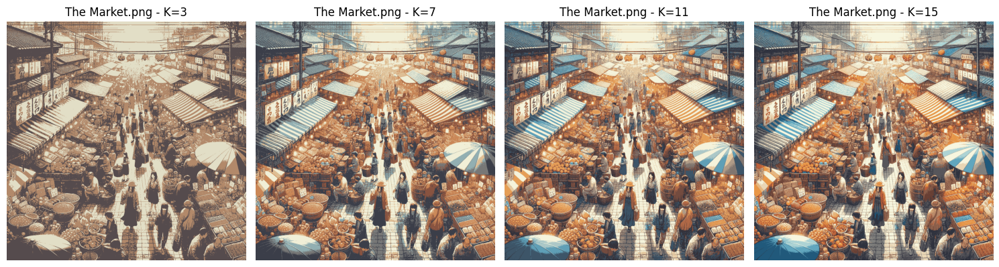

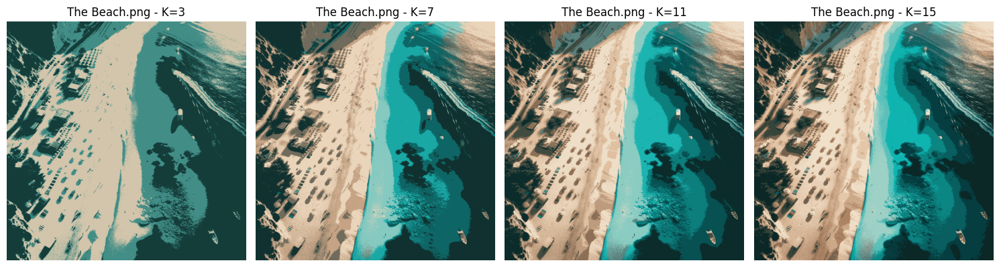

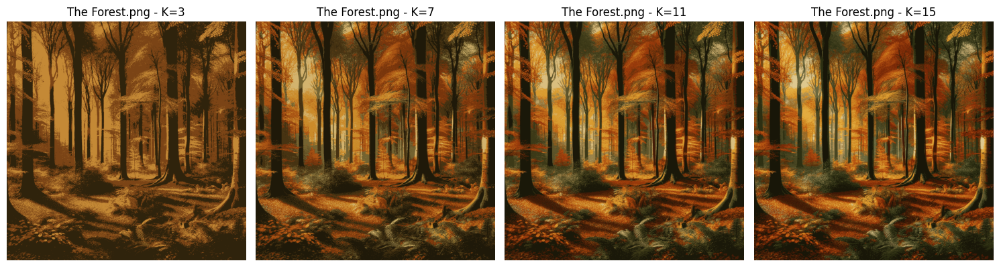

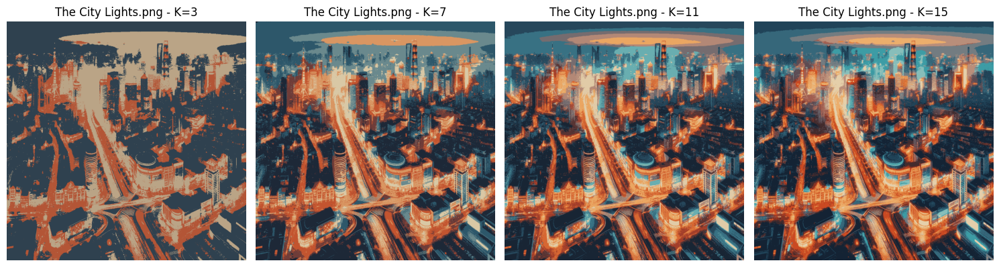

In [5]:
# kmeans normal

def load_image(image_path):
    # Load the image
    image = cv2.imread(image_path)
    if image is None:
        raise ValueError(f"Image at {image_path} could not be loaded.")
    # Convert from BGR to RGB
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    return image

def augment_features(image, use_xy_coordinates=False):
    # Normalize pixel values to be between 0 and 1
    normalized_image = image / 255.0
    features = normalized_image.reshape(-1, 3)  # Reshape to (num_pixels, 3)
    return features

def kmeans_segmentation(features, n_clusters, original_shape):
    # Apply K-means clustering on features
    kmeans = KMeans(n_clusters=n_clusters, random_state=0, n_init=10).fit(features)
    labels = kmeans.labels_
    segmented_image = kmeans.cluster_centers_[labels]

    # Reshape to the original image shape
    segmented_image = segmented_image.reshape(original_shape)
    segmented_image = (segmented_image * 255).astype(np.uint8)

    return segmented_image

def process_images(image_paths, cluster_counts):
    for image_path in image_paths:
        image = load_image(image_path)
        features = augment_features(image, use_xy_coordinates=False)
        
        # Create a figure with subplots
        fig, axes = plt.subplots(1, len(cluster_counts), figsize=(15, 5))

        # Loop through each cluster count
        for i, n_clusters in enumerate(cluster_counts):
            # Apply K-means and get the segmented image
            segmented_image = kmeans_segmentation(features, n_clusters, image.shape)

            # Display the segmented image in the corresponding subplot
            axes[i].imshow(segmented_image)
            axes[i].set_title(f"{image_path.split('/')[-1]} - K={n_clusters}")
            axes[i].axis('off')

        # Adjust layout
        plt.tight_layout()
        plt.show()

# Example usage
images = image_paths = ['The Market.png', 'The Beach.png',
                        'The Forest.png', 'The City Lights.png']  # Replace with your actual image paths
cluster_counts = [3, 7, 11, 15]
process_images(images, cluster_counts)


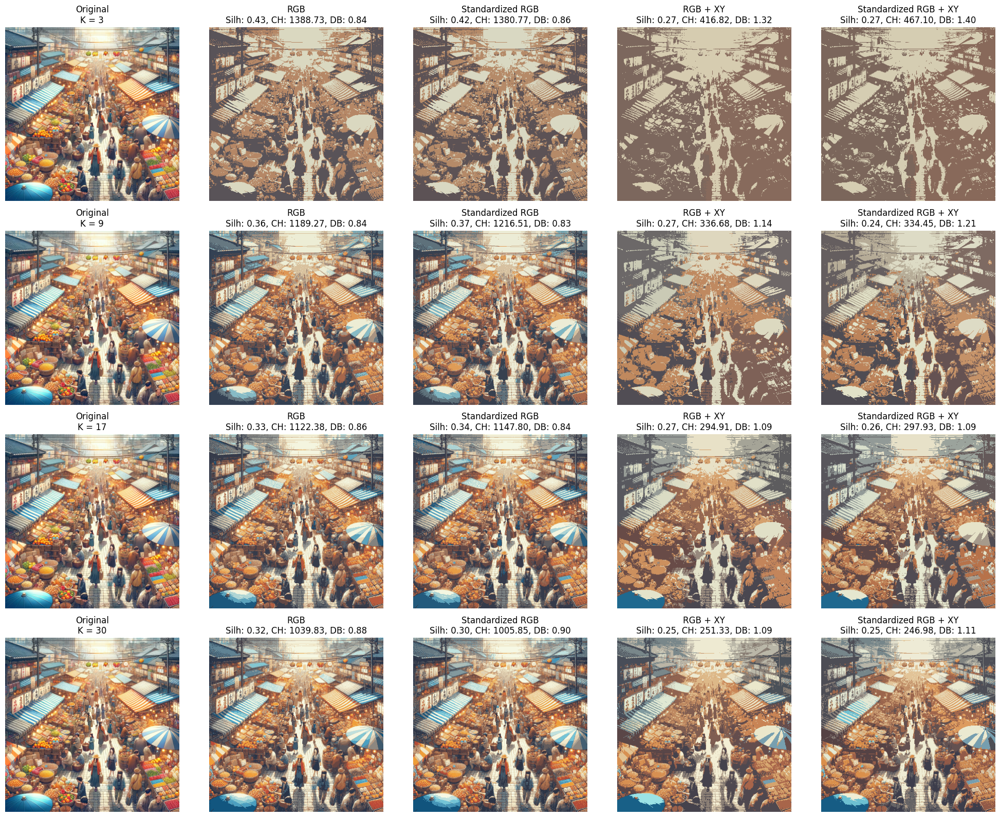

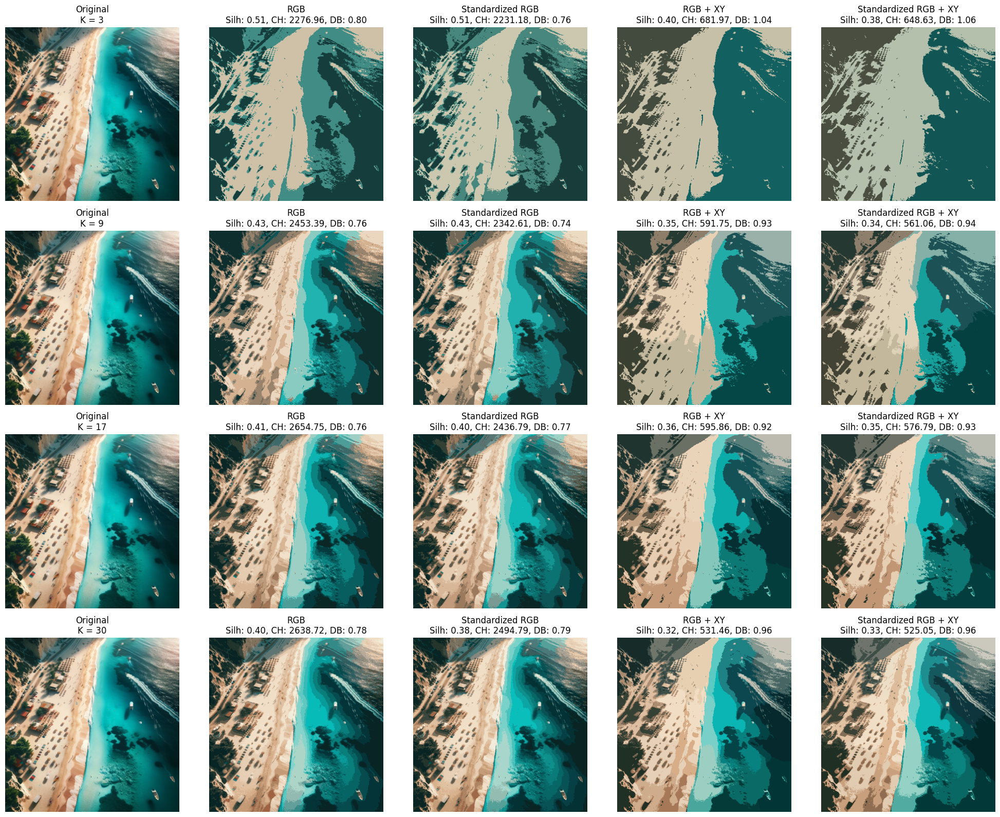

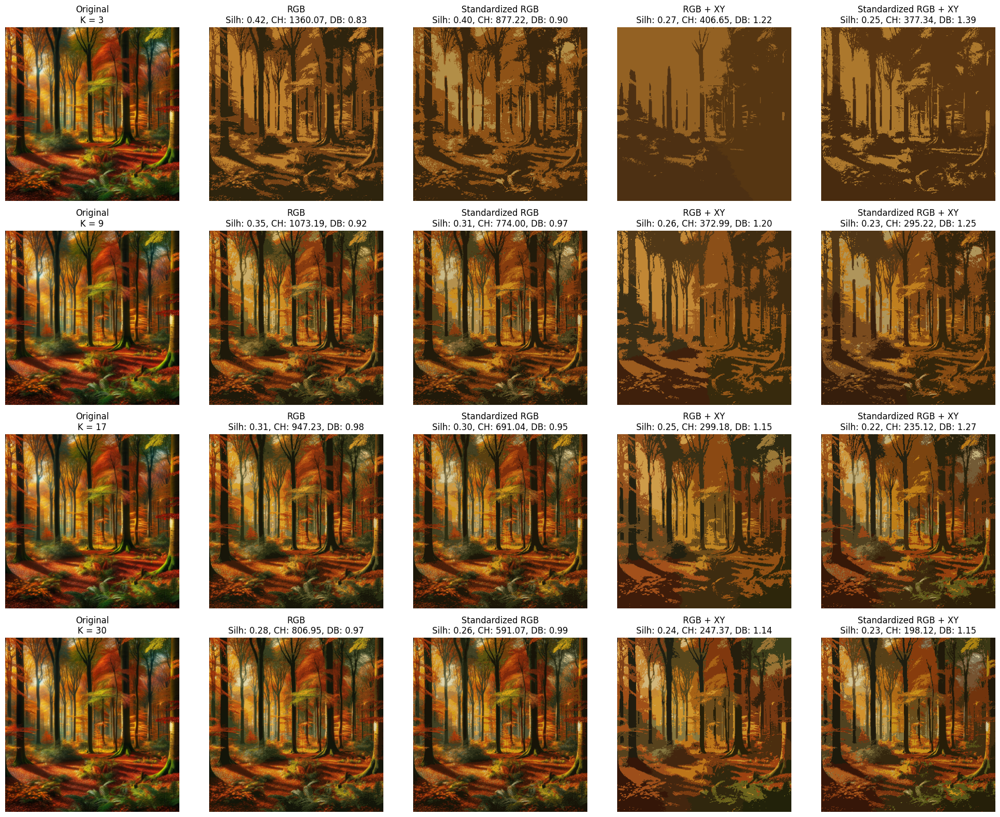

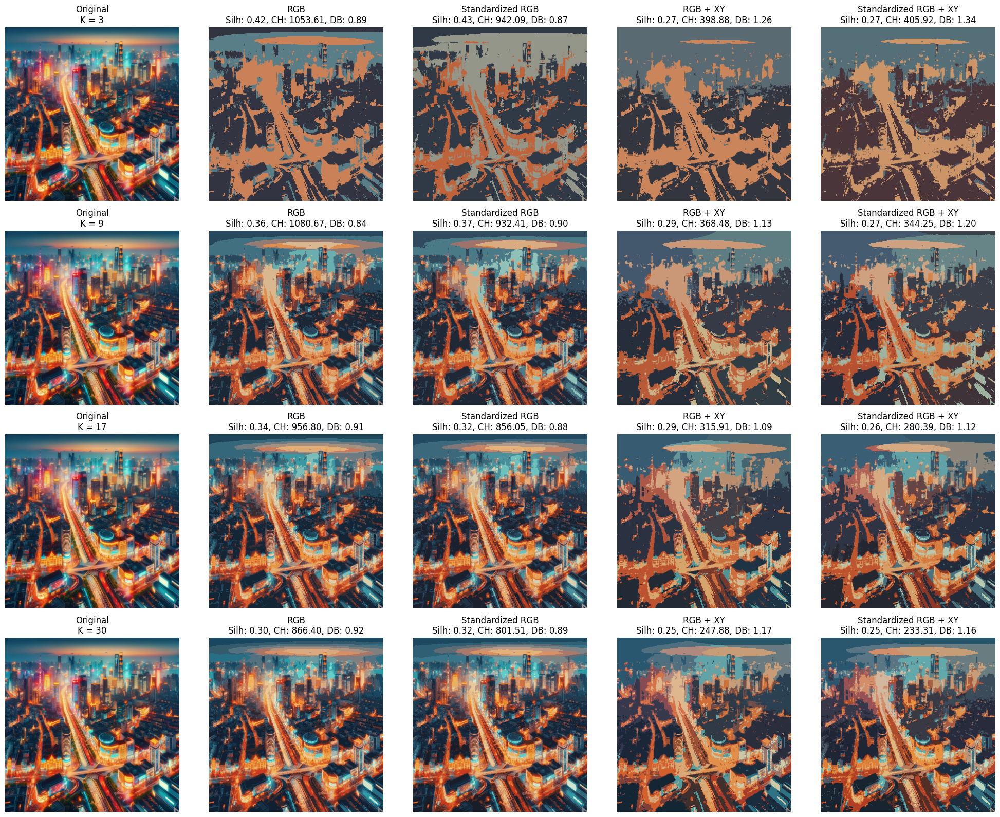

In [ ]:
#Kmeans complete part

def load_image(image_path, downsample_factor=1):
    # Load the image
    image = cv2.imread(image_path)
    if image is None:
        raise ValueError(f"Image at {image_path} could not be loaded.")
    # Downsample the image if downsample_factor is greater than 1
    if downsample_factor > 1:
        width = image.shape[1] // downsample_factor
        height = image.shape[0] // downsample_factor
        image = cv2.resize(image, (width, height), interpolation=cv2.INTER_AREA)
    # Convert from BGR to RGB
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    return image

def augment_features(image, use_xy_coordinates=False, standardize=False):
    # Normalize pixel values to be between 0 and 1
    normalized_image = image / 255.0
    features = normalized_image.reshape(-1, 3)  # Reshape to (num_pixels, 3)

    if use_xy_coordinates:
        # Augment features with pixel coordinates
        x_coord, y_coord = np.meshgrid(np.arange(image.shape[1]), np.arange(image.shape[0]))
        x_coord_norm = x_coord / x_coord.max()  # Normalize x coordinates
        y_coord_norm = y_coord / y_coord.max()  # Normalize y coordinates
        features = np.concatenate((features, x_coord_norm.flatten().reshape(-1, 1), y_coord_norm.flatten().reshape(-1, 1)), axis=1)

    scaler = None
    if standardize:
        # Standardize features
        scaler = StandardScaler()
        features = scaler.fit_transform(features)

    return features, scaler

def kmeans_segmentation(features, scaler, n_clusters, original_shape):
    # Apply K-means clustering on features
    kmeans = KMeans(n_clusters=n_clusters, random_state=0, n_init=10).fit(features)
    labels = kmeans.labels_

    # If the features were standardized, inverse transform the cluster centers
    if scaler:
        cluster_centers = scaler.inverse_transform(kmeans.cluster_centers_)
    else:
        cluster_centers = kmeans.cluster_centers_

    segmented_image = cluster_centers[labels]

    # Reshape to the original image shape and convert to original color space
    segmented_image = segmented_image[:, :3]  # Use only color for clustering
    segmented_image = segmented_image.reshape(original_shape)
    segmented_image = (segmented_image * 255).astype(np.uint8)

    return segmented_image, labels

def calculate_scores(features, labels, sample_size=1000):
    # Randomly sample a subset of features and labels if the dataset is large
    if len(features) > sample_size:
        np.random.seed(0)  # Ensures reproducibility
        indices = np.random.choice(len(features), sample_size, replace=False)
        sampled_features = features[indices]
        sampled_labels = labels[indices]
    else:
        sampled_features = features
        sampled_labels = labels

    silhouette = silhouette_score(sampled_features, sampled_labels)
    calinski_harabasz = calinski_harabasz_score(sampled_features, sampled_labels)
    davies_bouldin = davies_bouldin_score(sampled_features, sampled_labels)
    return silhouette, calinski_harabasz, davies_bouldin

def process_and_compare_images(image_paths, cluster_list):
    for image_path in image_paths:
        image = load_image(image_path, downsample_factor=3)
        original_shape = image.shape
        title_base = image_path.split('/')[-1].split('.')[0]

        # Create a figure for all subplots
        plt.figure(figsize=(20, 4 * len(cluster_list)))

        for i, n_clusters in enumerate(cluster_list):
            # Process images with different parameters
            features_rgb, scaler_rgb = augment_features(image, use_xy_coordinates=False, standardize=False)
            features_rgb_std, scaler_rgb_std = augment_features(image, use_xy_coordinates=False, standardize=True)
            features_rgb_xy, scaler_rgb_xy = augment_features(image, use_xy_coordinates=True, standardize=False)
            features_rgb_xy_std, scaler_rgb_xy_std = augment_features(image, use_xy_coordinates=True, standardize=True)

            segmented_rgb, labels_rgb = kmeans_segmentation(features_rgb, None, n_clusters, original_shape)
            segmented_rgb_std, labels_rgb_std = kmeans_segmentation(features_rgb_std, scaler_rgb_std, n_clusters, original_shape)
            segmented_rgb_xy, labels_rgb_xy = kmeans_segmentation(features_rgb_xy, None, n_clusters, original_shape)
            segmented_rgb_xy_std, labels_rgb_xy_std = kmeans_segmentation(features_rgb_xy_std, scaler_rgb_xy_std, n_clusters, original_shape)

            # Calculate scores
            scores_rgb = calculate_scores(features_rgb, labels_rgb)
            scores_rgb_std = calculate_scores(features_rgb_std, labels_rgb_std)
            scores_rgb_xy = calculate_scores(features_rgb_xy, labels_rgb_xy)
            scores_rgb_xy_std = calculate_scores(features_rgb_xy_std, labels_rgb_xy_std)

            # Plotting
            segmentations = [segmented_rgb, segmented_rgb_std, segmented_rgb_xy, segmented_rgb_xy_std]
            titles = ["RGB", "Standardized RGB", "RGB + XY", "Standardized RGB + XY"]
            scores = [scores_rgb, scores_rgb_std, scores_rgb_xy, scores_rgb_xy_std]

            # Add original image in the first column of each row
            plt.subplot(len(cluster_list), 5, i * 5 + 1)
            plt.imshow(image)
            plt.title(f'Original\nK = {n_clusters}')
            plt.axis('off')

            # Add the segmented images
            for j, (segmented_image, score) in enumerate(zip(segmentations, scores)):
                plt.subplot(len(cluster_list), 5, i * 5 + j + 2)
                plt.imshow(segmented_image)
                plt.title(f'{titles[j]}\nSilh: {score[0]:.2f}, CH: {score[1]:.2f}, DB: {score[2]:.2f}')
                plt.axis('off')

        plt.tight_layout()
        plt.show()


cluster_values = [3, 9, 17, 30]  # List of different cluster values to test
images = ['The Market.png', 'The Beach.png', 'The Forest.png', 'The City Lights.png'] 
process_and_compare_images(images, cluster_values)

# 27s first image
# 2m 17s all images

Several criteria are employed in cluster analysis to assess the caliber of the clustering outcomes. The Davies-Bouldin Index, the Calinski-Harabasz Index, and the Silhouette Coefficient are three often used measures. These metrics evaluate the quality of clustering from many angles:

1. **Silhouette Coefficient**:
   - **Meaning**: This metric measures how similar an object is to its own cluster (cohesion) compared to other clusters (separation).
   - **High Value**: A high silhouette value indicates that the object is well matched to its own cluster and poorly matched to neighboring clusters. If the average silhouette value of all objects is high, it suggests that the clustering configuration is appropriate.
   - **Low/Negative Value**: A low or negative silhouette value indicates that the object is either not well matched to its own cluster or is equally well matched to multiple clusters. This might suggest overlapping clusters or an inappropriate clustering configuration.

2. **Calinski-Harabasz Index** (also known as the Variance Ratio Criterion):
   - **Meaning**: This index is defined as the ratio of the sum of between-clusters dispersion and of within-cluster dispersion for all clusters. Essentially, it measures the dispersion between and within clusters.
   - **High Value**: A higher value of this index indicates better-defined clusters. It means that clusters are dense and well separated, which is often considered as an indication of a good clustering structure.
   - **Low Value**: A lower value indicates poorly defined clusters with high within-cluster variance and low between-cluster variance.

3. **Davies-Bouldin Index**:
   - **Meaning**: This index is a function of the ratio of the sum of within-cluster scatter to between-cluster separation. Unlike the other two, it considers the average similarity of each cluster with its most similar cluster.
   - **High Value**: A high value indicates poor clustering. It means the clusters are closer to each other and less distinct.
   - **Low Value**: A low Davies-Bouldin index indicates better clustering. It suggests that clusters are compact (low within-cluster scatter) and well separated.

To summarize: 
- A high Silhouette Coefficient, low Davies-Bouldin Index, and a high Calinski-Harabasz Index are often indicative of a solid clustering outcome.
- A low or negative Silhouette Coefficient, a low Calinski-Harabasz Index, and a high Davies-Bouldin Index might all point to a bad clustering outcome.


---

we can how increasing number of clusters `K` is providing more colors to the image, when we used `k=3` for example, it searched for the most 3 used colors and apply it to the hole image, and so on, I applied 4 values of `K` in each row and when k where 30 it gives the best of the avilable clusters.

---

in each of the 5 colmuns, I ploted something as the following: `1st: original image`, `2nd: RGB`, `3rd: Standardized RGB`, `4th: RGB + XY`, `5th: Standardized RGB + XY`,as you see.
first of all I had to `downsample the image` to make it faster in computing to get smaller victor. this won't affect that much in `Kmeans & GMM` butwill affect in `DBscan`.

second thing is the values of `Silh`, `CH` and `DB`, as we see and lets take the road image (the last one) as an example:

- **Silhouette (Silh) Score**: Ranges from -1 to 1. A higher Silh score suggests better separation between the clusters. 
  - As K increases, the Silh score generally decreases. This can indicate that as you divide the data into more clusters, the clarity of separation between those clusters might be diminishing.

- **Calinski-Harabasz (CH) Index**: A higher score is better. It suggests that the clusters are dense and well separated.
  - The CH score tends to decrease with larger K. This is often because creating more clusters usually means the between-cluster variance decreases as clusters get closer to each other.

- **Davies-Bouldin (DB) Index**: A lower score is better. It indicates that the clusters are compact and separated from each other.
  - The DB score generally increases with the number of clusters, suggesting that the clusters might be less distinct from each other as K grows.

In the provided image, we can observe this general info:

- The relative higher Silh scores for lower values of K (e.g., K = 3) may indicate better cluster delineation. But the Silh scores go down when K goes up, suggesting that it gets harder to tell one cluster from another.


- The CH values are highest for the smallest number of clusters (K = 3) and decrease as K increases, reinforcing the idea that the cluster separation becomes less pronounced with more clusters.

- The DB index increases with the number of clusters, which indicates that the quality of clustering may be decreasing since the clusters are less distinct and more dispersed.

`the optimal number of clusters K is often a balance between maximizing the Silh score and CH index while minimizing the DB index`. However, the interpretation can be more complex depending on the specific domain, the nature of the data, and the purpose of the clustering.



We note that different preprocessing techniques and metrics (represented by K) are applied to assess the clustering quality over a range of cluster sizes in the offered clustering findings. As K increases, the silhouette scores often decline, indicating that clusters become less identifiable. As K rises, the Calinski-Harabasz Index likewise falls, suggesting that in scenarios with more clusters, the difference between them is less obvious. On the other hand, the Davies-Bouldin Index rises with K, supporting the idea that cluster quality may decrease as clusters are less compact and more alike. These patterns draw attention to the trade-offs involved in deciding how many clusters to use for a particular dataset and emphasize how crucial it is to balance these measures in order to have the best possible clustering arrangement.


---
### Gaussian Mixture Models (GMM) for Image Segmentation

A sophisticated clustering method that is sometimes thought of as an expansion of K-means clustering is called Gaussian Mixture Models (GMM). Although K-means has certain limitations, GMM offers a more adaptable method of clustering by taking the data distribution into account in addition to point-to-point distance.

Because GMM can handle more complicated structures in a picture, it can be very useful in image segmentation. Unlike K-means, which assumes clusters are spherical, GMM can adapt to elliptical or irregularly shaped clusters, making it more adaptable for real-world pictures.


GMM works for image segmentation as the following:
1. **Initialization:** For each cluster, the procedure begins by estimating the parameters of a Gaussian distribution. This comprises the covariance, which provides information about the cluster's shape and direction, and the mean, which functions similarly to the center in K-means.
2. **Expectation:** In this step, the algorithm estimates the probability that each pixel in the image belongs to each cluster, based on the current parameters of the Gaussian distributions.
3. **Maximization:** The parameters of the Gaussian distributions are updated based on the probabilities calculated in the expectation step. The goal is to maximize the likelihood of the data given these parameters.
4. **Repeat:** The Expectation and Maximization steps are repeated iteratively until the parameters of the Gaussian distributions stabilize.

The versatility of GMM makes it a good choice for picture segmentation. Compared to K-means, it can handle complicated color distributions more well. For instance, GMM might more precisely distinguish between several image segments in a picture with shadows and fluctuating light conditions, catching subtleties that K-means could overlook.

A more sophisticated and flexible method is provided by GMM, which is particularly helpful for pictures with intricate color distributions or non-spherical clusters.

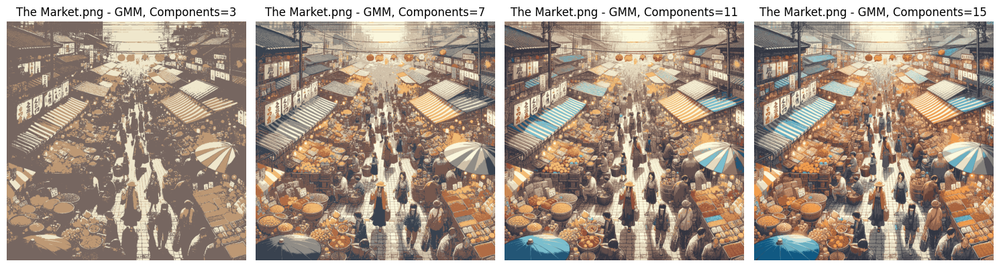

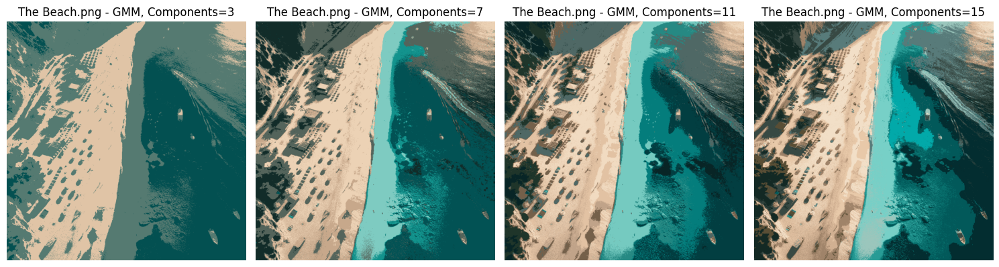

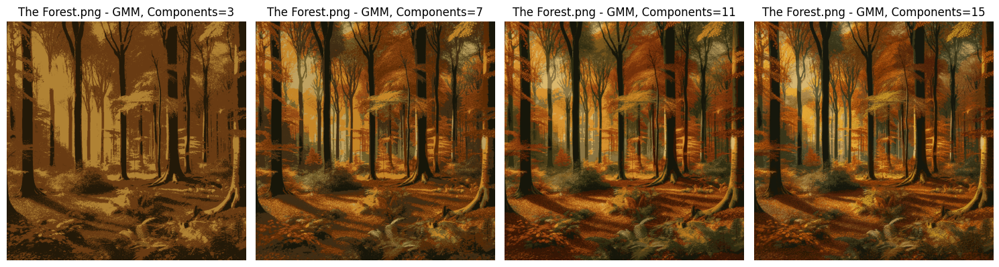

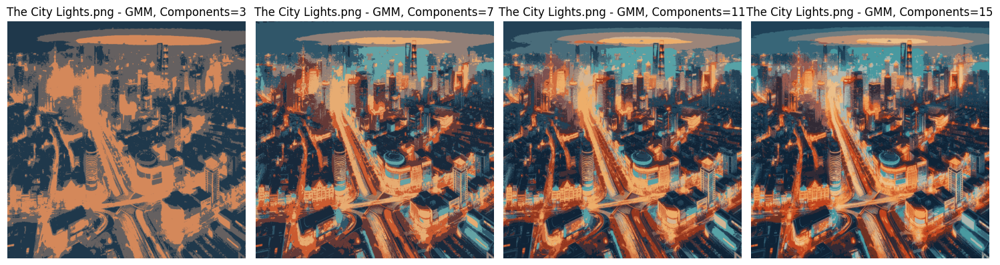

In [6]:
# GMM normal

def load_image(image_path):
    # Load the image
    image = cv2.imread(image_path)
    if image is None:
        raise ValueError(f"Image at {image_path} could not be loaded.")
    # Convert from BGR to RGB
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    return image

def augment_features(image, use_xy_coordinates=False):
    # Normalize pixel values to be between 0 and 1
    normalized_image = image / 255.0
    features = normalized_image.reshape(-1, 3)  # Reshape to (num_pixels, 3)
    return features

def gmm_segmentation(features, n_components, original_shape):
    # Apply GMM clustering on features
    gmm = GaussianMixture(n_components=n_components, random_state=0).fit(features)
    labels = gmm.predict(features)
    segmented_image = gmm.means_[labels]

    # Reshape to the original image shape
    segmented_image = segmented_image.reshape(original_shape)
    segmented_image = (segmented_image * 255).astype(np.uint8)

    return segmented_image

def process_images(image_paths, component_counts):
    for image_path in image_paths:
        image = load_image(image_path)
        features = augment_features(image, use_xy_coordinates=False)
        
        # Create a figure with subplots
        fig, axes = plt.subplots(1, len(component_counts), figsize=(15, 5))

        # Loop through each number of components
        for i, n_components in enumerate(component_counts):
            # Apply GMM and get the segmented image
            segmented_image = gmm_segmentation(features, n_components, image.shape)

            # Display the segmented image in the corresponding subplot
            axes[i].imshow(segmented_image)
            axes[i].set_title(f"{image_path.split('/')[-1]} - GMM, Components={n_components}")
            axes[i].axis('off')

        # Adjust layout
        plt.tight_layout()
        plt.show()

# Example usage
# images = ['The Market.png', 'The Beach.png', 'The Forest.png', 'The City Lights.png']  # Replace with your actual image paths
        
component_counts = [3, 7, 11, 15]  # These are the equivalent of clusters in K-Means
process_images(images, component_counts)


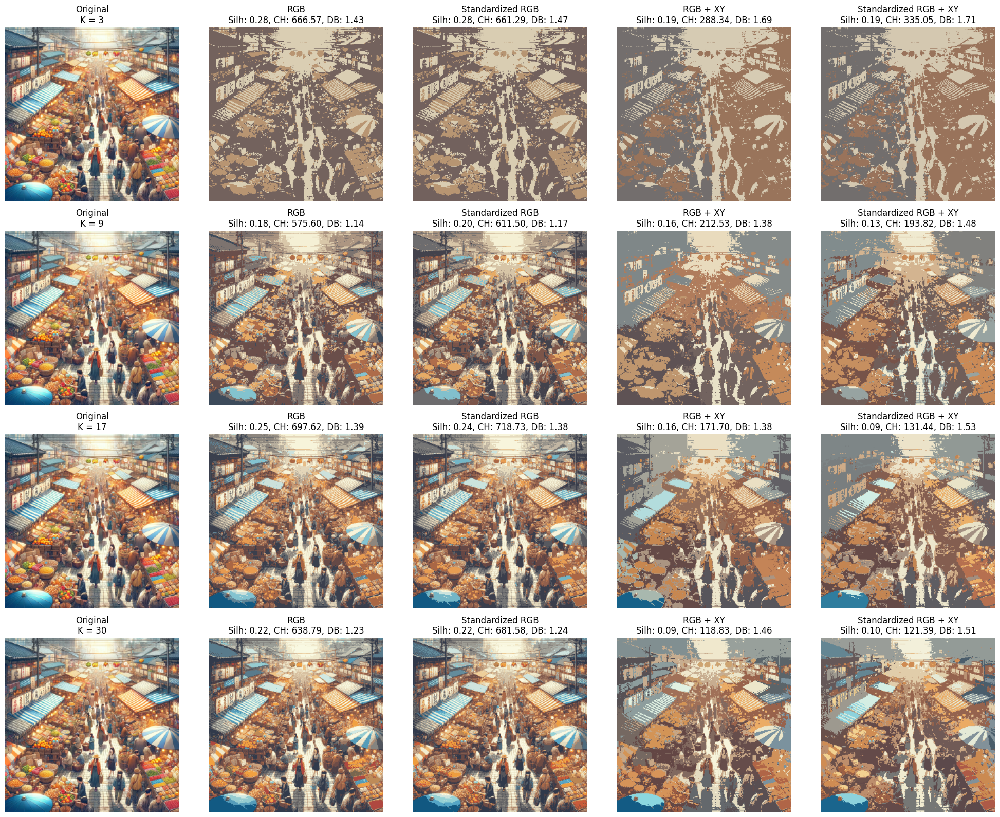

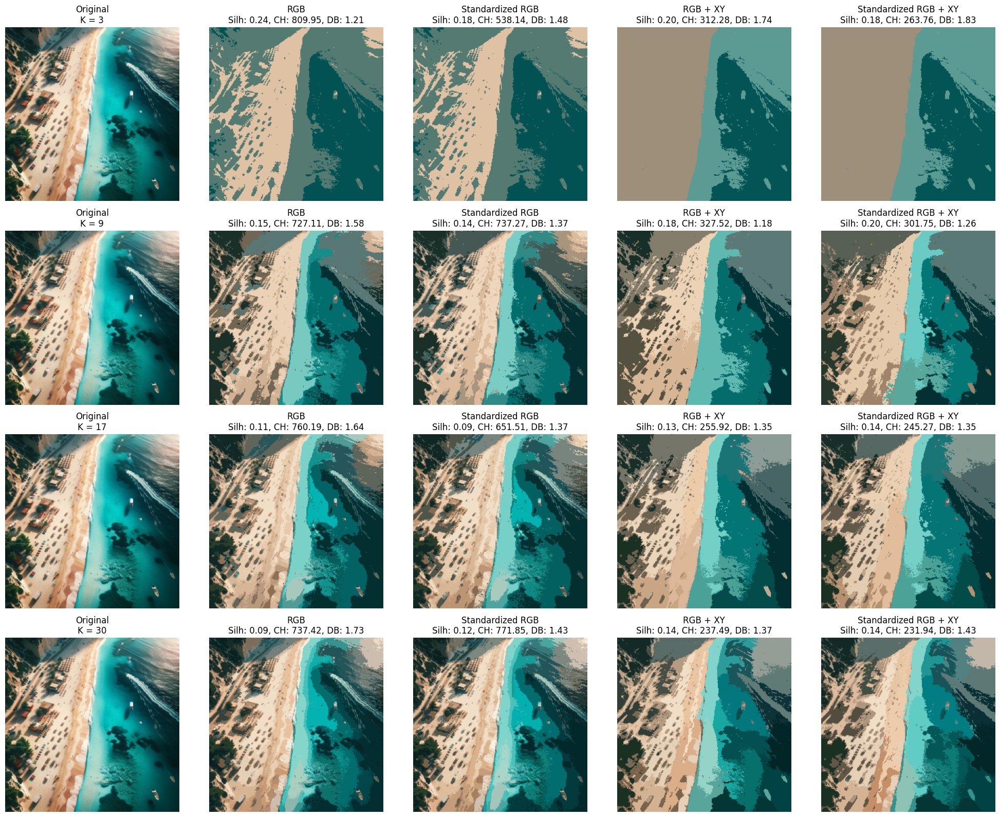

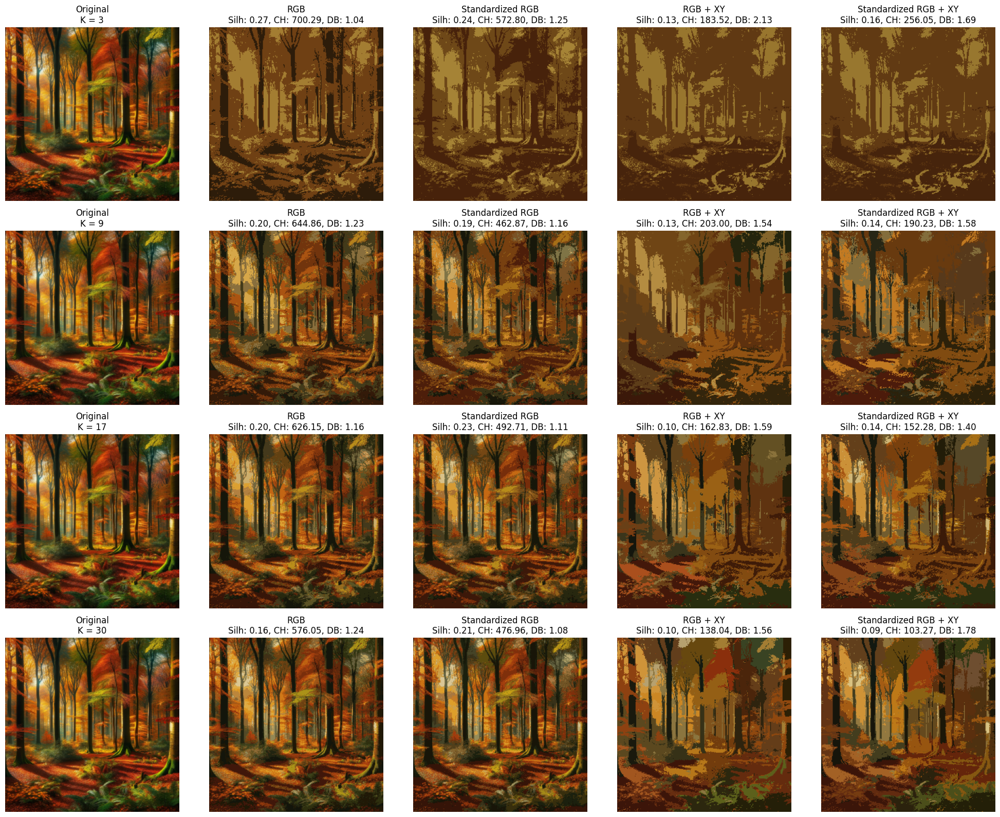

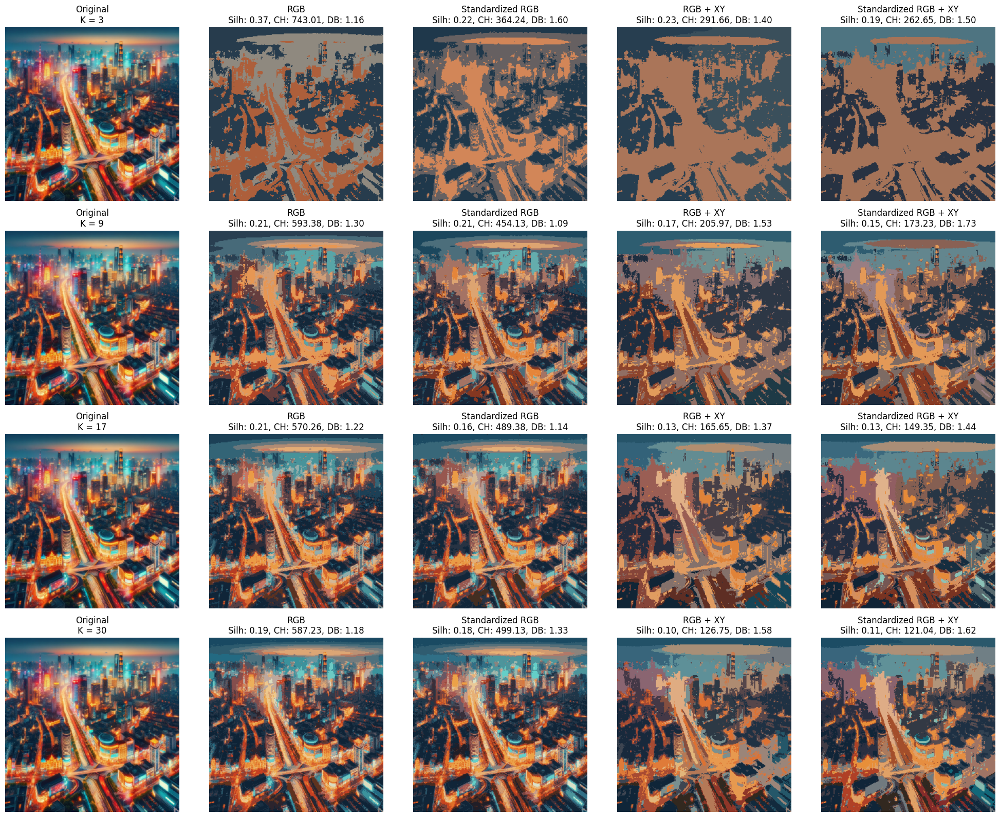

In [16]:
#GMM complete part

def load_image(image_path, downsample_factor=1):
    # Load the image
    image = cv2.imread(image_path)
    if image is None:
        raise ValueError(f"Image at {image_path} could not be loaded.")
    # Downsample the image if downsample_factor is greater than 1
    if downsample_factor > 1:
        width = image.shape[1] // downsample_factor
        height = image.shape[0] // downsample_factor
        image = cv2.resize(image, (width, height), interpolation=cv2.INTER_AREA)
    # Convert from BGR to RGB
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    return image

def augment_features(image, use_xy_coordinates=False, standardize=False):
    # Normalize pixel values to be between 0 and 1
    normalized_image = image / 255.0
    features = normalized_image.reshape(-1, 3)  # Reshape to (num_pixels, 3)

    if use_xy_coordinates:
        # Augment features with pixel coordinates
        x_coord, y_coord = np.meshgrid(np.arange(image.shape[1]), np.arange(image.shape[0]))
        x_coord_norm = x_coord / x_coord.max()  # Normalize x coordinates
        y_coord_norm = y_coord / y_coord.max()  # Normalize y coordinates
        features = np.concatenate((features, x_coord_norm.flatten().reshape(-1, 1), y_coord_norm.flatten().reshape(-1, 1)), axis=1)

    scaler = None
    if standardize:
        # Standardize features
        scaler = StandardScaler()
        features = scaler.fit_transform(features)

    return features, scaler

def gmm_segmentation(features, scaler, n_clusters, original_shape):
    # Apply GMM clustering on features
    gmm = GaussianMixture(n_components=n_clusters, random_state=0).fit(features)
    labels = gmm.predict(features)

    # Inverse transform the cluster centers if the features were standardized
    if scaler:
        means = scaler.inverse_transform(gmm.means_)
    else:
        means = gmm.means_

    segmented_image = means[labels]

    # Reshape to the original image shape and convert to original color space
    segmented_image = segmented_image[:, :3]  # Use only color for clustering
    segmented_image = segmented_image.reshape(original_shape)
    segmented_image = (segmented_image * 255).astype(np.uint8)

    return segmented_image, labels

def calculate_scores(features, labels, sample_size=1000):
    # Randomly sample a subset of features and labels if the dataset is large
    if len(features) > sample_size:
        np.random.seed(0)  # Ensures reproducibility
        indices = np.random.choice(len(features), sample_size, replace=False)
        sampled_features = features[indices]
        sampled_labels = labels[indices]
    else:
        sampled_features = features
        sampled_labels = labels

    silhouette = silhouette_score(sampled_features, sampled_labels)
    calinski_harabasz = calinski_harabasz_score(sampled_features, sampled_labels)
    davies_bouldin = davies_bouldin_score(sampled_features, sampled_labels)
    return silhouette, calinski_harabasz, davies_bouldin

def process_and_compare_images_gmm(image_paths, cluster_list):
    for image_path in image_paths:
        image = load_image(image_path, downsample_factor=4)
        original_shape = image.shape
        title_base = image_path.split('/')[-1].split('.')[0]

        # Create a figure for all subplots
        plt.figure(figsize=(20, 4 * len(cluster_list)))

        for i, n_clusters in enumerate(cluster_list):
            # Process images with different parameters
            features_rgb, scaler_rgb = augment_features(image, use_xy_coordinates=False, standardize=False)
            features_rgb_std, scaler_rgb_std = augment_features(image, use_xy_coordinates=False, standardize=True)
            features_rgb_xy, scaler_rgb_xy = augment_features(image, use_xy_coordinates=True, standardize=False)
            features_rgb_xy_std, scaler_rgb_xy_std = augment_features(image, use_xy_coordinates=True, standardize=True)

            segmented_rgb, labels_rgb = gmm_segmentation(features_rgb, None, n_clusters, original_shape)
            segmented_rgb_std, labels_rgb_std = gmm_segmentation(features_rgb_std, scaler_rgb_std, n_clusters, original_shape)
            segmented_rgb_xy, labels_rgb_xy = gmm_segmentation(features_rgb_xy, None, n_clusters, original_shape)
            segmented_rgb_xy_std, labels_rgb_xy_std = gmm_segmentation(features_rgb_xy_std, scaler_rgb_xy_std, n_clusters, original_shape)

            # Calculate scores
            scores_rgb = calculate_scores(features_rgb, labels_rgb)
            scores_rgb_std = calculate_scores(features_rgb_std, labels_rgb_std)
            scores_rgb_xy = calculate_scores(features_rgb_xy, labels_rgb_xy)
            scores_rgb_xy_std = calculate_scores(features_rgb_xy_std, labels_rgb_xy_std)

            # Plotting
            segmentations = [segmented_rgb, segmented_rgb_std, segmented_rgb_xy, segmented_rgb_xy_std]
            titles = ["RGB", "Standardized RGB", "RGB + XY", "Standardized RGB + XY"]
            scores = [scores_rgb, scores_rgb_std, scores_rgb_xy, scores_rgb_xy_std]

            # Add original image in the first column of each row
            plt.subplot(len(cluster_list), 5, i * 5 + 1)
            plt.imshow(image)
            plt.title(f'Original\nK = {n_clusters}')
            plt.axis('off')

            # Add the segmented images
            for j, (segmented_image, score) in enumerate(zip(segmentations, scores)):
                plt.subplot(len(cluster_list), 5, i * 5 + j + 2)
                plt.imshow(segmented_image)
                plt.title(f'{titles[j]}\nSilh: {score[0]:.2f}, CH: {score[1]:.2f}, DB: {score[2]:.2f}')
                plt.axis('off')

        plt.tight_layout()
        plt.show()

# Define the path to your images
images = ['The Market.png', 'The Beach.png', 'The Forest.png', 'The City Lights.png'] 
cluster_values = [3, 9, 17, 30]  # List of different cluster values to test
process_and_compare_images_gmm(images, cluster_values)
# 1m 5s first image

In the context of Gaussian Mixture Models `(GMM)`, the clustering evaluation metrics such as the Silhouette score, Calinski-Harabasz Index, and Davies-Bouldin Index serve a similar purpose as they do with K-means or any other clustering technique. They aim to measure the quality of the clusters produced by the model. The metrics in relation to the `GMM` outputs shown in the image:

- **Silhouette (Silh) Score**: This score assesses the consistency within clusters. For `GMM`, a higher score means that the data points are more correctly matched to the Gaussian distributions that represent the clusters. The decreasing silhouette scores with increasing K suggest that the clusters may be less cohesive and more overlapping as the number of Gaussians increases.

- **Calinski-Harabasz (CH) Index**: High values of this index generally indicate that the clusters are well separated and dense, which is desirable in clustering. In the context of `GMM`, it means that the Gaussians are well separated and the data points are close to the centers of their respective Gaussians. The declining CH scores with higher K values may indicate that the separation between the different Gaussian distributions is decreasing.

- **Davies-Bouldin (DB) Index**: For `GMM`, a lower Davies-Bouldin score is preferred, indicating compact clusters that are far from each other. The increasing DB scores with larger K values indicate that the model is creating more clusters that are not as well separated and have higher variance within them, which could suggest overfitting.

Given these observations, the `GMM` results:

We can see that different metrics have been applied to evaluate the cluster quality for varying numbers of components (K), as indicated in the clustering results of the Gaussian Mixture Model. As K grows, the silhouette scores show a declining trend, suggesting that there is a greater degree of overlap between the Gaussian distributions that represent the clusters. This might lead to a decrease in the clarity of the cluster assignments. In a similar vein, the Calinski-Harabasz Index has a declining tendency as the number of components rises, which may indicate that the Gaussians' distinctness and separation are decreasing. Lastly, the rising Davies-Bouldin Index values for higher K indicate that the compactness and separation of the clusters may be diminishing, hinting at a possible overfitting scenario where the model is too complex for the underlying data structure. These trends underscore the importance of choosing an appropriate number of components in `GMM` to balance between overfitting and underfitting, aiming for a model that accurately captures the inherent groupings within the data.

---
---

### DBSCAN Clustering for Image Segmentation

The number of clusters need not be predetermined while using DBSCAN. Rather, it uses the density of data points to identify clusters, automatically distinguishing between high-density regions (the clusters) and low-density regions (the noise).

Here's how DBSCAN works for image segmentation:
1. **Core Points Identification:** DBSCAN starts by identifying 'core points'. A point is a core point if a specified minimum number of points (MinPts) are within a given radius (ε) of it. These core points are the heart of a cluster.
2. **Cluster Formation:** From each core point, DBSCAN explores its neighborhood (within ε) and adds all points found to the cluster. If it finds other core points in this process, their neighbors are also added to the cluster. This step continues until all points in the cluster are visited.
3. **Handling Noise:** Any point that is not within ε of a core point is considered noise and is not included in any cluster. This makes DBSCAN very effective at handling outliers.
4. **Creating More Clusters:** The process repeats for each unvisited core point, forming new clusters. 

When dealing with pictures that have regions of varied density, DBSCAN can be particularly useful in the context of image segmentation. For example, DBSCAN can distinguish, regardless of the geometry of these regions, between the thick forest sections (clusters) and the clearings (noise or distinct clusters) in an aerial shot of a forest with dispersed clearings.

In [35]:
# DBscan Full
def load_image(image_path, downsample_factor=1):
    # Load the image
    image = cv2.imread(image_path)
    if image is None:
        raise ValueError(f"Image at {image_path} could not be loaded.")
    # Downsample the image if downsample_factor is greater than 1
    if downsample_factor > 1:
        width = image.shape[1] // downsample_factor
        height = image.shape[0] // downsample_factor
        image = cv2.resize(image, (width, height), interpolation=cv2.INTER_AREA)
    # Convert from BGR to RGB
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    return image

def augment_features(image, use_xy_coordinates=False, standardize=False):
    # Normalize pixel values to be between 0 and 1
    normalized_image = image / 255.0
    features = normalized_image.reshape(-1, 3)  # Reshape to (num_pixels, 3)

    if use_xy_coordinates:
        # Augment features with pixel coordinates
        x_coord, y_coord = np.meshgrid(np.arange(image.shape[1]), np.arange(image.shape[0]))
        x_coord_norm = x_coord / x_coord.max()  # Normalize x coordinates
        y_coord_norm = y_coord / y_coord.max()  # Normalize y coordinates
        features = np.concatenate((features, x_coord_norm.flatten().reshape(-1, 1), y_coord_norm.flatten().reshape(-1, 1)), axis=1)

    scaler = None
    if standardize:
        # Standardize features
        scaler = StandardScaler()
        features = scaler.fit_transform(features)

    return features, scaler

def calculate_scores(features, labels):
    # Filter out noise points with label == -1
    core_samples_mask = labels != -1
    if np.all(~core_samples_mask):
        # If all points are noise, return NaN
        return np.nan, np.nan, np.nan
    
    # Only use non-noise points to calculate scores
    features_core = features[core_samples_mask]
    labels_core = labels[core_samples_mask]
    
    # Check if there are at least 2 clusters to calculate the scores
    if len(np.unique(labels_core)) < 2:
        return np.nan, np.nan, np.nan  # Return NaN if not enough clusters
    
    silhouette = silhouette_score(features_core, labels_core) if len(np.unique(labels_core)) > 1 else np.nan
    calinski_harabasz = calinski_harabasz_score(features_core, labels_core) if len(np.unique(labels_core)) > 1 else np.nan
    davies_bouldin = davies_bouldin_score(features_core, labels_core) if len(np.unique(labels_core)) > 1 else np.nan

    return silhouette, calinski_harabasz, davies_bouldin

def dbscan_segmentation(features, scaler, eps, min_samples, original_shape):
    # Apply DBSCAN clustering on features
    dbscan = DBSCAN(eps=eps, min_samples=min_samples, n_jobs=-1).fit(features)
    labels = dbscan.labels_
    
    # Identify core samples
    core_samples_mask = np.zeros_like(labels, dtype=bool)
    core_samples_mask[dbscan.core_sample_indices_] = True
    
    # Number of clusters in labels, ignoring noise if present
    n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)

    unique_labels = set(labels)
    
    # Create an array to hold the color for each cluster
    colors = [plt.cm.Spectral(each) for each in np.linspace(0, 1, len(unique_labels))]
    
    # Assign color to each pixel based on its cluster label
    clustered_image = np.zeros((len(labels), 3))
    for k, col in zip(unique_labels, colors):
        if k == -1:
            # Black used for noise
            col = [0, 0, 0, 1]

        class_member_mask = (labels == k)

        xy = features[class_member_mask & core_samples_mask]
        clustered_image[class_member_mask & core_samples_mask] = col[:3]
        
        xy = features[class_member_mask & ~core_samples_mask]
        clustered_image[class_member_mask & ~core_samples_mask] = col[:3]
    
    # Reshape to the original image shape
    clustered_image = clustered_image.reshape(original_shape)
    clustered_image = (clustered_image * 255).astype(np.uint8)

    return clustered_image, labels

def process_and_compare_images(image_paths, eps=0.5, min_samples=5):
    for image_path in image_paths:
        image = load_image(image_path, downsample_factor=4)
        original_shape = image.shape
        title_base = image_path.split('/')[-1].split('.')[0]
        
        # Process images with different parameters
        features_rgb, scaler_rgb = augment_features(image, use_xy_coordinates=False, standardize=False)
        features_rgb_std, scaler_rgb_std = augment_features(image, use_xy_coordinates=False, standardize=True)
        features_rgb_xy, scaler_rgb_xy = augment_features(image, use_xy_coordinates=True, standardize=False)
        features_rgb_xy_std, scaler_rgb_xy_std = augment_features(image, use_xy_coordinates=True, standardize=True)
        
        # Segment images using DBSCAN and get labels
        clustered_rgb, labels_rgb = dbscan_segmentation(features_rgb, None, eps, min_samples, original_shape)
        clustered_rgb_std, labels_rgb_std = dbscan_segmentation(features_rgb_std, scaler_rgb_std, eps, min_samples, original_shape)
        clustered_rgb_xy, labels_rgb_xy = dbscan_segmentation(features_rgb_xy, None, eps, min_samples, original_shape)
        clustered_rgb_xy_std, labels_rgb_xy_std = dbscan_segmentation(features_rgb_xy_std, scaler_rgb_xy_std, eps, min_samples, original_shape)
        
        # Calculate scores using the labels returned from the segmentation function
        scores_rgb = calculate_scores(features_rgb, labels_rgb)
        scores_rgb_std = calculate_scores(features_rgb_std, labels_rgb_std)
        scores_rgb_xy = calculate_scores(features_rgb_xy, labels_rgb_xy)
        scores_rgb_xy_std = calculate_scores(features_rgb_xy_std, labels_rgb_xy_std)
        
        
        # Plot the results
        plt.figure(figsize=(16, 5))
        
        plt.subplot(151)
        plt.imshow(image)
        plt.title(f'{title_base}_original')
        plt.axis('off')
        
        plt.subplot(152)
        plt.imshow(clustered_rgb)
        plt.title(f'{title_base}_rgb\nSilh: {scores_rgb[0]:.2f}, CH: {scores_rgb[1]:.2f}, DB: {scores_rgb[2]:.2f}')
        plt.axis('off')
        
        plt.subplot(153)
        plt.imshow(clustered_rgb_std)
        plt.title(f'{title_base}_standardized_rgb\nSilh: {scores_rgb_std[0]:.2f}, CH: {scores_rgb_std[1]:.2f}, DB: {scores_rgb_std[2]:.2f}')
        plt.axis('off')
        
        plt.subplot(154)
        plt.imshow(clustered_rgb_xy)
        plt.title(f'{title_base}_rgb_xy\nSilh: {scores_rgb_xy[0]:.2f}, CH: {scores_rgb_xy[1]:.2f}, DB: {scores_rgb_xy[2]:.2f}')
        plt.axis('off')
        
        plt.subplot(155)
        plt.imshow(clustered_rgb_xy_std)
        plt.title(f'{title_base}_standardized_rgb_xy\nSilh: {scores_rgb_xy_std[0]:.2f}, CH: {scores_rgb_xy_std[1]:.2f}, DB: {scores_rgb_xy_std[2]:.2f}')
        plt.axis('off')
        
        plt.suptitle(f'DBSCAN with eps = {eps}, min_samples = {min_samples}')
        plt.tight_layout()
        plt.show()

# Define the path to your images
images = ['image.jpg']  # Update with the path to your images


I'll use the bird image as the first 4 images are complex to be determined and clustered by `DBscan` 

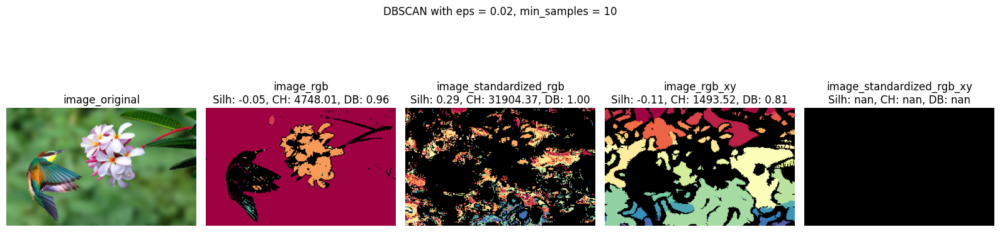

In [36]:
process_and_compare_images(images, eps=0.02, min_samples=10)

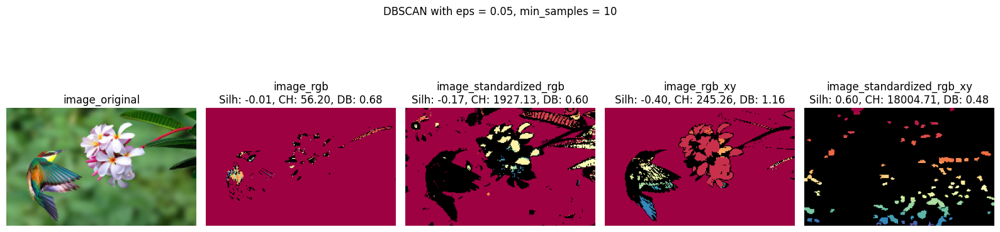

In [20]:
process_and_compare_images(images, eps=0.05, min_samples=10)

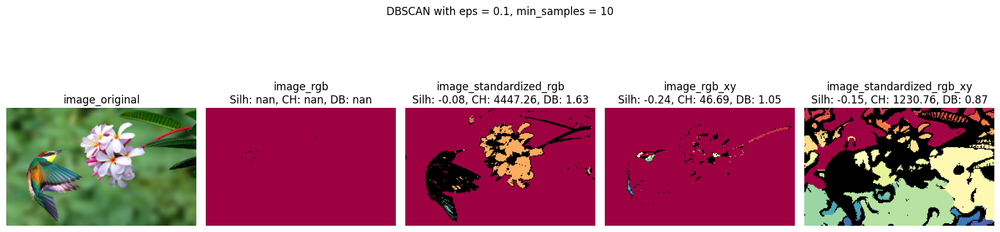

In [22]:
process_and_compare_images(images, eps=0.1, min_samples=10)

we can see here the effict of increasing the `eps` value on the RGB images and how increasing this hyperparameter make the clusters to be combined in somehow the scores view this by numbers too.

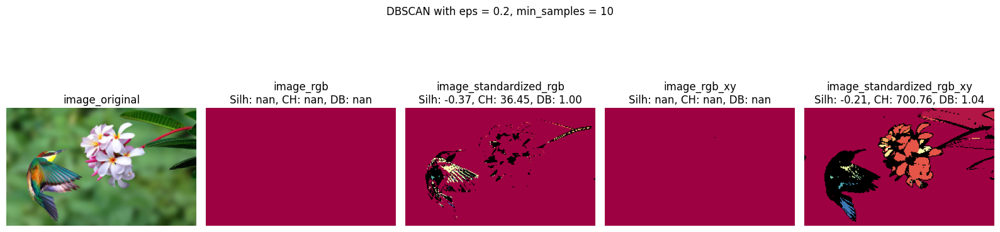

In [23]:
process_and_compare_images(images, eps=0.2, min_samples=10)

we can see here in the 3rd and 5th images how Silh is higher in the 5 and higher with CH and small diffreance in DB which means a good clustered image as total.

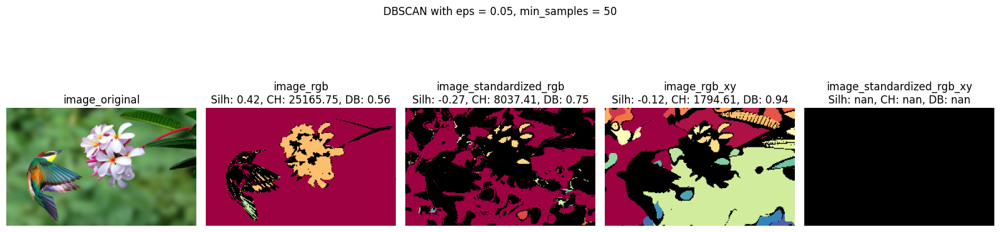

In [25]:
process_and_compare_images(images, eps=0.05, min_samples=50)

we can note that standardization makes it worse, The `eps` parameter is suitable for original RGB, but not suitable for normalized intensity

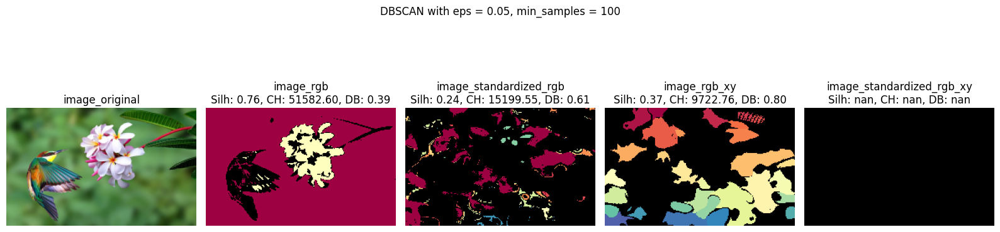

In [26]:
process_and_compare_images(images, eps=0.05, min_samples=100)

in those 2 images we fixed the `eps` and changed the `min_samples` hyperparameter and got:
the original RGB image with `min_samples=100` has a high Silhouette score, which suggests that the clusters identified are quite distinct. This could be because, with a high `min_samples` value, only very dense areas are identified as clusters, resulting in a few, well-separated clusters. However, it's also possible that the algorithm is only picking up a small number of very distinct features in the image, and the rest is being labeled as noise (which is not included in the Silhouette score calculation).

`Negative Silhouette Scores for Standardized Features:`

When the natural clusters within the picture data are distorted during the standardization procedure, negative silhouette scores may result. Standardization may not be appropriate for picture colors that exhibit intrinsic clustering depending on their original scale, as it presupposes that the data should follow a distribution with unit variance and a center of gravity around zero. Consequently, following normalization, points can be closer to clusters to which they do not belong, resulting in lower Silhouette scores.

`Variations in CH and DB Scores:`

Because the Calinski-Harabasz index does not take noise points into account, it may be high in situations where a few strong clusters exist even when the majority of the data is classified as noise.
The Davies-Bouldin scores seem relatively low across the board, but they are not consistent. For standardized features with `min_samples=50`, the score is relatively high, which could indicate that the clusters formed are not very distinct from each other. This inconsistency could be due to the distortion caused by standardization.

`Non-Applicable (NaN) Scores:`

The NaN scores for some configurations suggest that the algorithm was unable to form clusters due to the chosen parameters. This is most likely because the `eps` and `min_samples` parameters are set in such a way that no points meet the criteria to form a core point, leading to all points being labeled as noise (I implemented it in `calculate_scores` function). As the Silhouette, Calinski-Harabasz, and Davies-Bouldin scores require at least two clusters to compute, they return NaN when the algorithm detects no clusters.


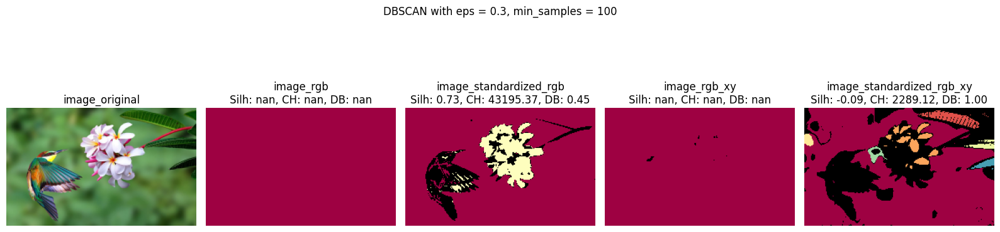

In [28]:
process_and_compare_images(images, eps=0.3, min_samples=100)

1. **Effect of `eps` and `min_samples`:**
   - **Epsilon (`eps`)**: This parameter determines the radius of the neighborhood around each point. When `eps` is small, the algorithm will form clusters with points that are very close to each other, leading to a larger number of smaller clusters. As `eps` increases, more points fall within the neighborhood of each point, which can cause clusters to merge and interfere with each other, as noted in the first three images. This is particularly visible in the RGB image (second column), where increasing `eps` leads to larger, less distinct clusters. If `eps` is too large, a single cluster may dominate, or all points may be considered noise.
   - **Minimum Samples (`min_samples`)**: This parameter defines the minimum number of points required to form a dense region, which is considered a cluster. A low `min_samples` value will consider smaller groups of points as clusters, leading to a higher number of clusters. As `min_samples` increases, the algorithm requires more points to form a cluster, which can result in fewer clusters and more points being labeled as noise. This parameter's effect can be sensitive to the size of the dataset. For example, in a high-resolution image (like 4K), a small `min_samples` value may not be sufficient to capture the true clusters because the density of points is much higher.

2. **Impact of Image Size and Standardization:**
   - **Image Size**: Larger images have more pixels, which translates to more data points for clustering. When the image size increases (like moving from a standard resolution to 4K), the same `min_samples` value may become less effective because it represents a smaller proportion of the data points. Therefore, for larger images, you might need to increase `min_samples` to maintain the same level of cluster "strictness".
   - **Standardization**: Usually, the characteristics are scaled to have a zero mean and a one standard deviation as part of the standardization procedure. Although standardization is useful in many machine learning applications, it might not be appropriate for image clustering, particularly when DBSCAN is being used. This is because standardization has the potential to skew the pixel intensities' natural grouping, making it more difficult for DBSCAN to identify significant clusters based on color similarity. This may be the reason for the lower performance you get while using standardization for picture segmentation.

Based on the observed results:

Using the Davies-Bouldin, Silhouette, and Calinski-Harabasz scores, we may evaluate how the algorithm's parameters affect the quality of the clustering when DBSCAN clustering is applied to picture data.

The Silhouette score, which measures the cohesion within clusters and separation between them, tends to decrease with an increase in `eps`. This decrease suggests that as we allow DBSCAN to encompass more points within a cluster's neighborhood, the distinction between clusters becomes less clear, reducing the score. Negative Silhouette scores, as observed in some of the images, indicate that some points may be more appropriate for neighboring clusters, or that the clusters are highly overlapping.

The Calinski-Harabasz index is a measure of cluster validity based on the ratio of between-clusters to within-cluster sum of squares. Higher values generally indicate clusters are well separated and dense. However, as `eps` increases, this score can decrease, signifying that the clusters are less well-defined and more spread out, as we can see in the results for larger `eps` values.

The Davies-Bouldin index aims for lower values, which would indicate compact clusters with low intra-cluster distances and high inter-cluster separation. As `eps` increases, the DB index can increase, implying that clusters are less distinct and potentially more scattered.

When considering the `min_samples` parameter, larger images with more data points require careful adjustment of this parameter. For instance, the same `min_samples` value that works for a lower resolution image may not be sufficient for a high-resolution image like a 4K one. This is because the density of points is much higher, and the relative density required to form a cluster should be adjusted accordingly. Failure to adjust `min_samples` appropriately for larger images may result in a poor clustering structure, as indicated by lower Calinski-Harabasz scores and higher Davies-Bouldin scores.

Furthermore, the quality of the clustering may suffer if the characteristics are standardized prior to clustering. Standardization can affect the intrinsic color distribution of pictures, producing less informative clusters, even though it is a frequent preprocessing step in many machine learning projects to standardize feature scales. The scores demonstrate this, with standardized pictures regularly displaying lower Davies-Bouldin, Silhouette, and Calinski-Harabasz scores than their non-standardized counterparts.

By encouraging spatial contiguity, including the xy coordinates as features in DBSCAN clustering modifies the segmentation outcomes. When working with only RGB values, clusters are created only on the basis of color, disregarding the spatial arrangement of the image. The addition of xy coordinates promotes the creation of geographically near clusters, resulting in segments that are more visually cohesive.

The segmentation findings show this spatial augmentation. When xy is present, clusters are more likely to be cohesive and aligned with the image's natural borders rather than spanning disjointed portions. With xy coordinates, metrics such as the Silhouette score usually get better because clusters get more definite and compact. The Calinski-Harabasz and Davies-Bouldin ratings also tend to reflect this improvement, showing denser and better-separated clusters.

Overall, the choice of `eps` and `min_samples` in DBSCAN must be fine-tuned according to the specific dataset and the desired clustering resolution. The clustering scores highlight the importance of these parameters in achieving meaningful segmentation of images, especially when dealing with varying image sizes and resolutions.

---
---
---

### conclusion

In conclusion, a big amount of information on the advantages and disadvantages of K-means, Gaussian Mixture Models (GMM), and Density-Based Spatial Clustering of Applications with Noise (DBSCAN) image segmentation techniques has been provided by our thorough assignment. The K-means method offered a reliable starting point, and its effectiveness was mostly influenced by the selection of K, or the number of clusters. The growing Davies-Bouldin indices and decreasing Silhouette scores showed a trade-off between possible loss of meaningful cluster differentiation and tighter segmentation as K grew.

GMMs introduced a probabilistic approach, allowing for soft clustering and greater flexibility in cluster shape. Although the GMM provided sophisticated segmentation, its performance also depended on the choice of a suitable number of Gaussian components, which was sophisticated by assessing the Davies-Bouldin, Calinski-Harabasz, and silhouette scores.

We switched to DBSCAN and embraced its ability to create clusters based on density instead of pre-determining cluster numbers. Adding xy coordinates to the feature space had a particularly revolutionary effect, resulting in more continuous clusters that followed the natural structure of the picture. DBSCAN's dependence on the `eps` and `min_samples` parameters need careful calibration, especially when working with different picture resolutions and scales, despite its resilience to outliers and noise.


The effect of feature augmentation and scaling was significant for all approaches. It appears that default feature normalization methods may not always be appropriate for picture data, since standardization of features frequently resulted in worse segmentation quality.

This comparative study has not only emphasized the specific factors essential for good picture segmentation but also the `subtle balance` required between `algorithmic complexity`, `feature representation`, and `parameter optimization`. The results highlight the fact that `there is no one-size-fits-all approach`; rather, each algorithm has a unique set of trade-offs that need to be carefully considered in order to get the intended segmentation result. The knowledge gained from this research will be crucial in helping us choose and use clustering algorithms for challenging picture segmentation tasks as we continue to push the limits of image analysis.
